# Reconocimiento de Matrículas

Este proyecto implementa una aplicación de video vigilancia capaz de reconocer las matrículas de los vehículos que aparecen en una secuencia de video, utilizando técnicas de OCR y procesamiento de imágenes.



## Objetivo

Este proyecto implementa una aplicación de video vigilancia capaz de reconocer las matrículas de los vehículos que aparecen en una secuencia de video. Las matrículas son un identificador único de los vehículos, por lo que ser capaz de reconocerlas es fundamental en aplicaciones de análisis de tráfico y sistemas del ámbito de Smart Cities.



## Configuración del Entorno

Se configuran las bibliotecas necesarias para el procesamiento de imágenes, reconocimiento de caracteres y visualización de resultados.



In [1]:
%matplotlib inline
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

from skimage import data, io, filters, transform
from skimage.filters import threshold_otsu
from skimage.color import rgb2gray
from skimage.measure import label
from skimage.util import invert
from skimage.measure import regionprops
from ipywidgets import interactive, IntSlider, FloatSlider
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler




import warnings
warnings.filterwarnings("ignore")

### Funciones Auxiliares

Se cargan funciones auxiliares desde el archivo `ocr.py` que facilitan el procesamiento y visualización de resultados.



In [2]:
from ocr import mostrar_blobs, mostrar_rois, mostrar_frames
from ocr import extraer_limites, genera_dataset, carga_dataset, extraer_ventana, dibujar_matches

### Dataset

Se utiliza un conjunto de imágenes de matrículas del dataset de la Universidad de Zagreb. Las imágenes se encuentran en la carpeta `dataset` y se cargan para su procesamiento.



In [3]:
dataset_rgb = io.ImageCollection('dataset/*.jpg')
print("Cargadas {} instancias.".format(len(dataset_rgb)))

Cargadas 8 instancias.


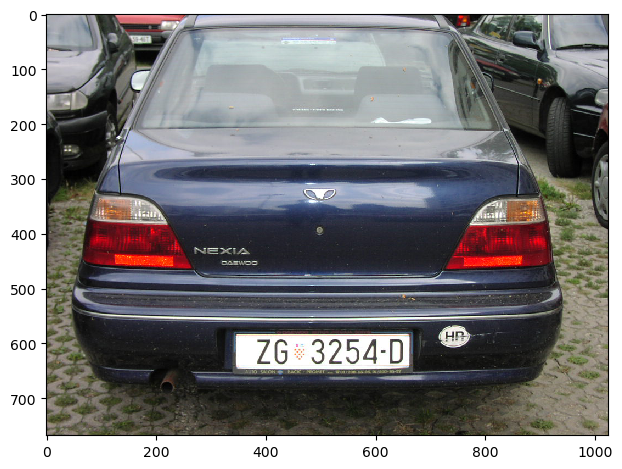

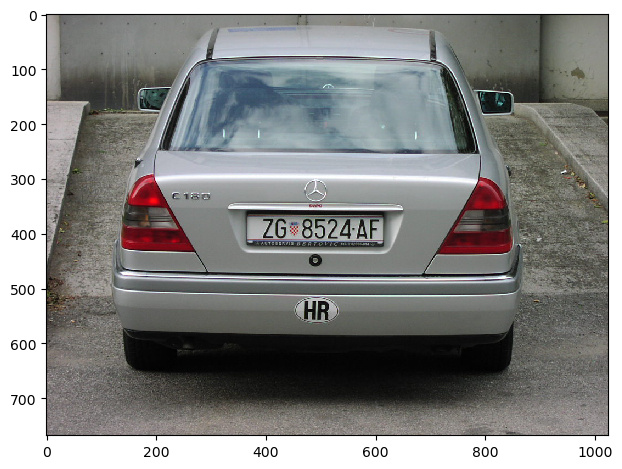

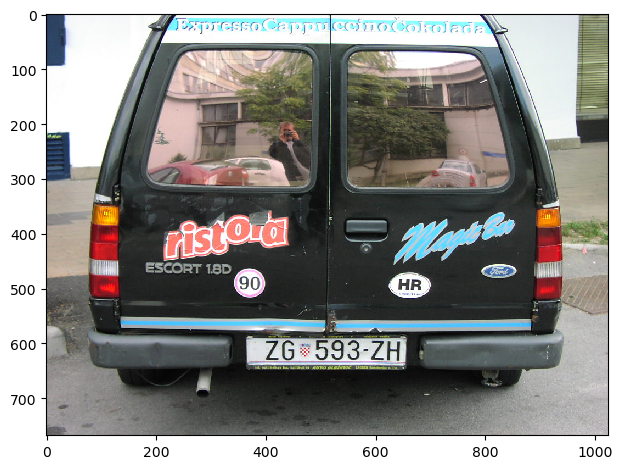

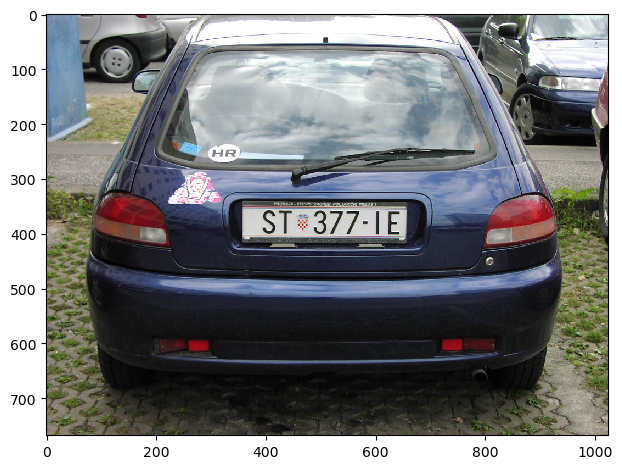

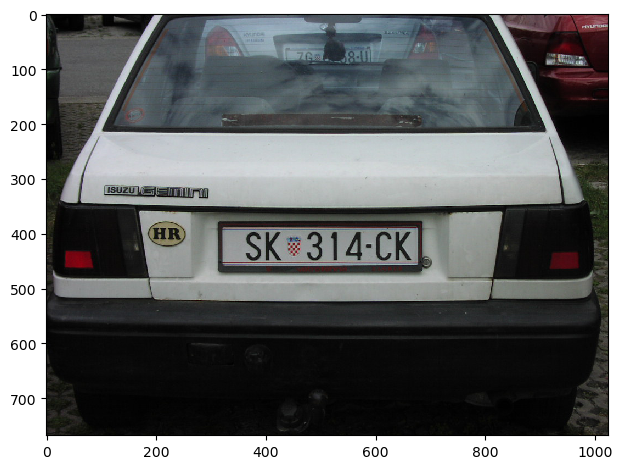

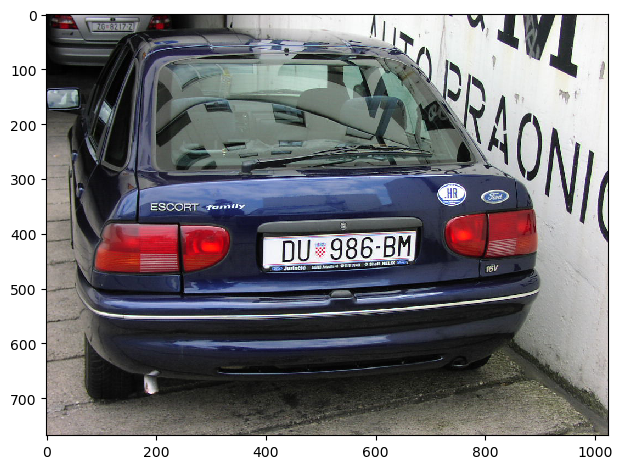

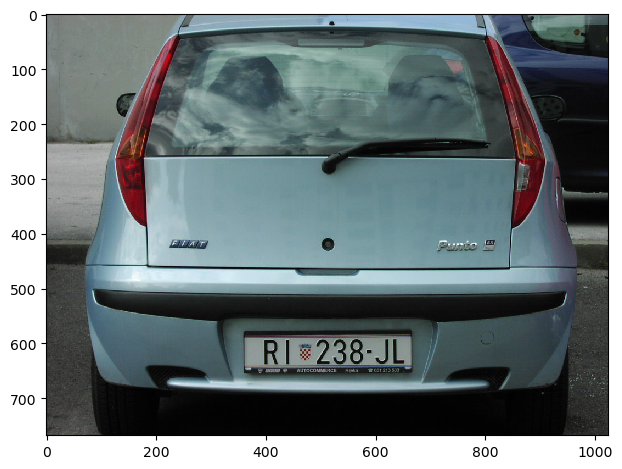

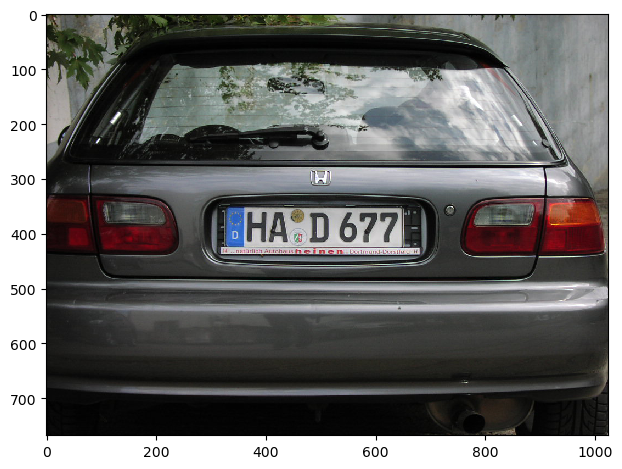

In [4]:
mostrar_frames(dataset_rgb)

### Conversión a Escala de Grises

Se convierten las imágenes de su espacio de color original RGB a escala de grises para simplificar el procesamiento y mejorar el rendimiento de las operaciones posteriores.



In [5]:
def convierte_a_gris_frames(imgs):
    """Función que recibe una lista de frames y que devuelve otra lista de frames convertidos en gris."""
    out = []
    
    # Convierto cada imagen RGB a escala de grises usando rgb2gray
    for img in imgs:
        img_gris = rgb2gray(img)
        out.append(img_gris)
    
    return out

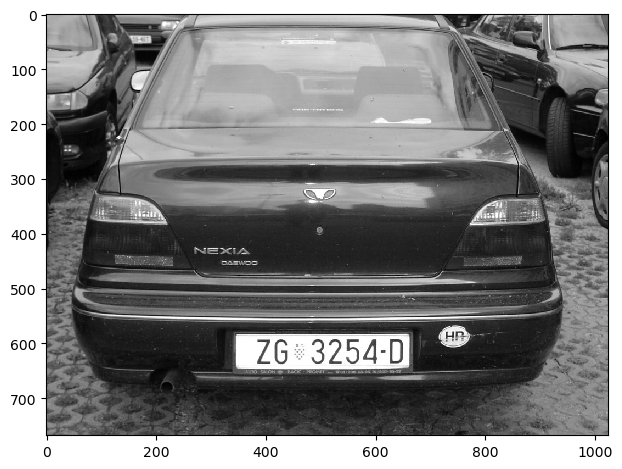

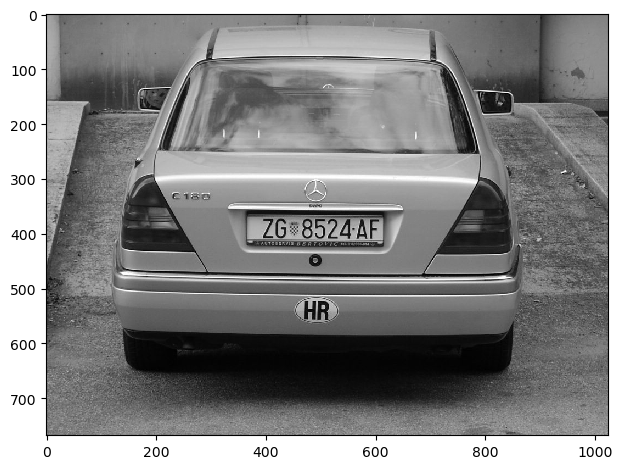

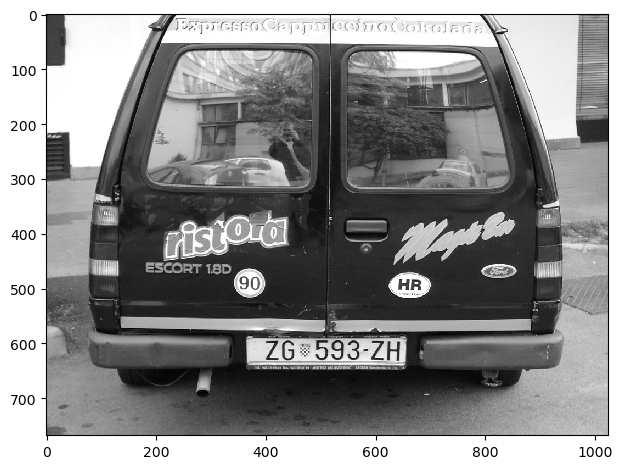

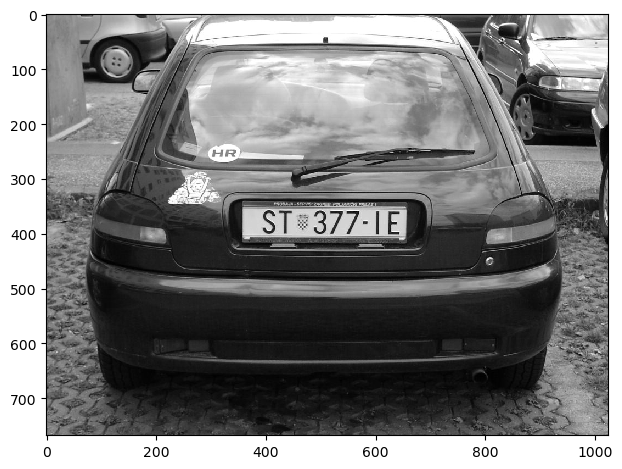

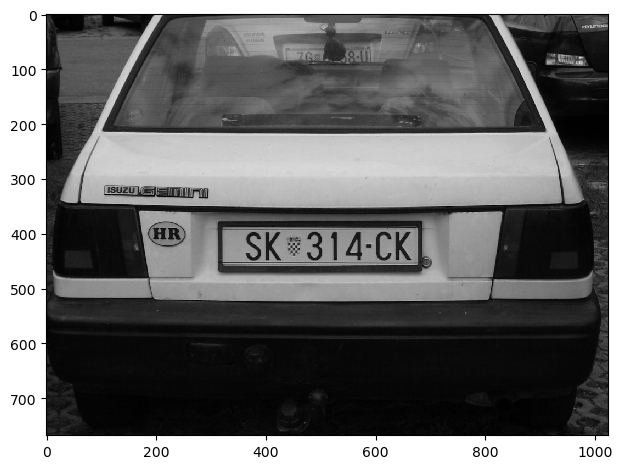

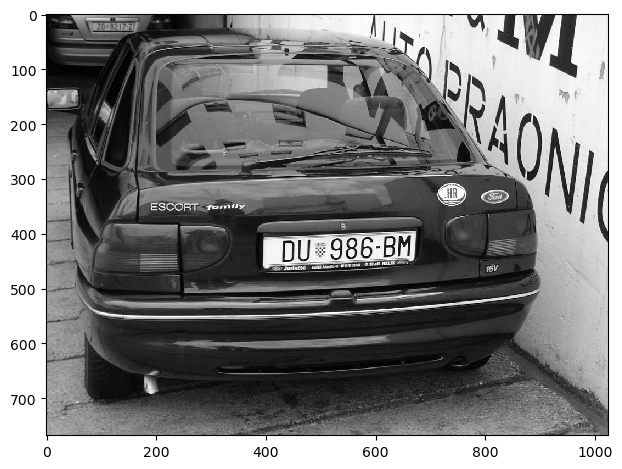

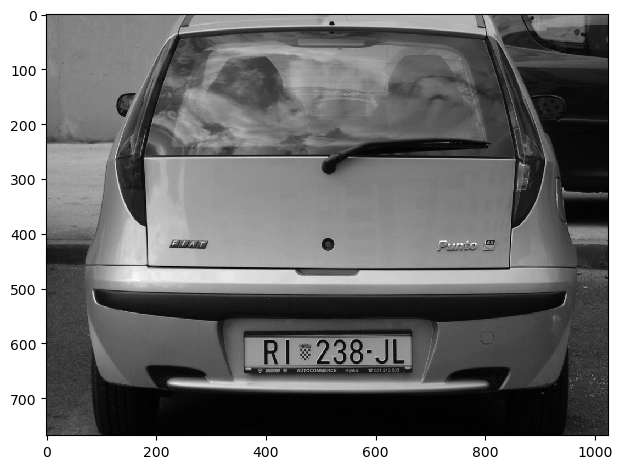

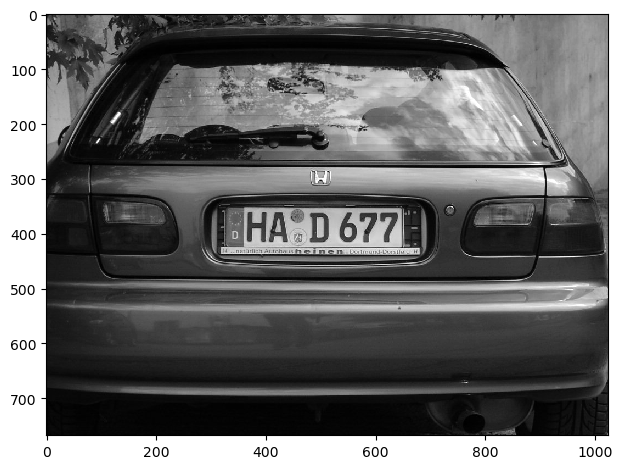

In [6]:
dataset_gris = convierte_a_gris_frames(dataset_rgb)
mostrar_frames(dataset_gris)

### Binarización

Una vez convertidas las imagenes a escala de grises vamos a binarizarlas:



In [7]:
from skimage.filters import threshold_local
def binariza_frames(imgs):
    out = []
    
    for img in imgs:
        block_size = 35
        
        # threshold_local calcula un umbral para cada píxel basado en su vecindario.
        adaptive_thresh = threshold_local(img, block_size, offset=0)
        
        # Aplicamos el umbral. La imagen resultante tendrá caracteres mucho más limpios y completos.
        img_binaria = img > adaptive_thresh
        
        out.append(img_binaria)
    
    return out

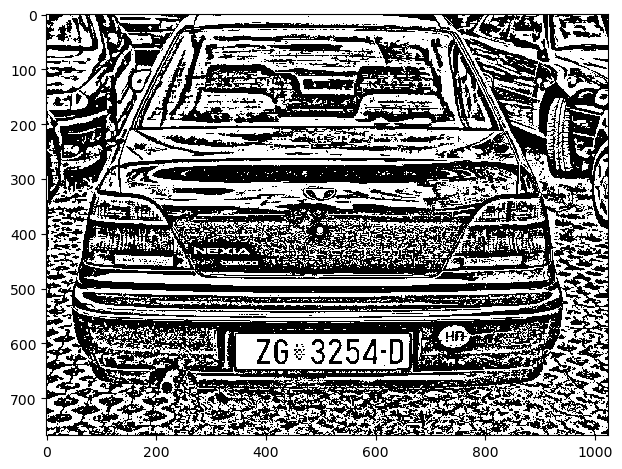

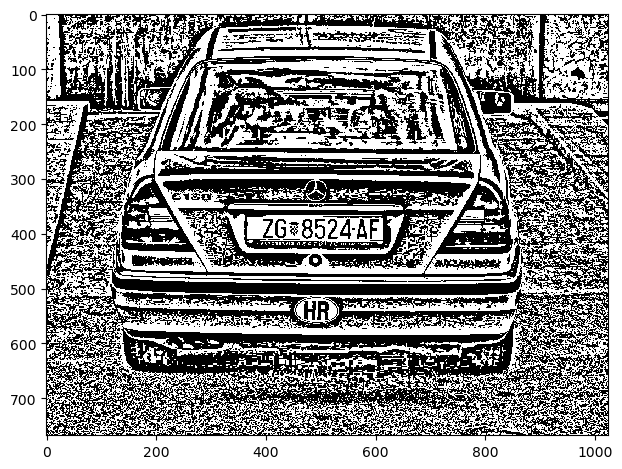

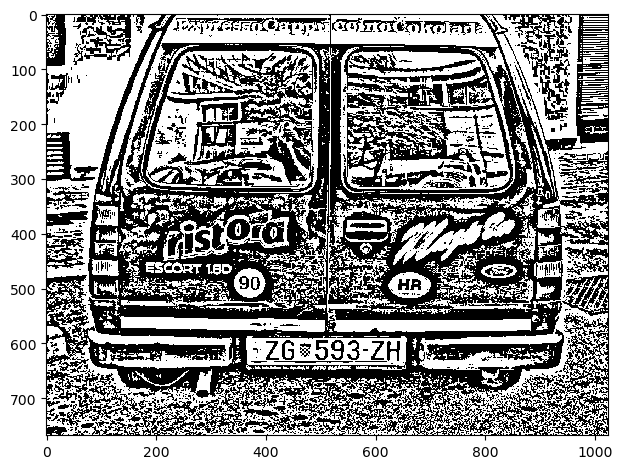

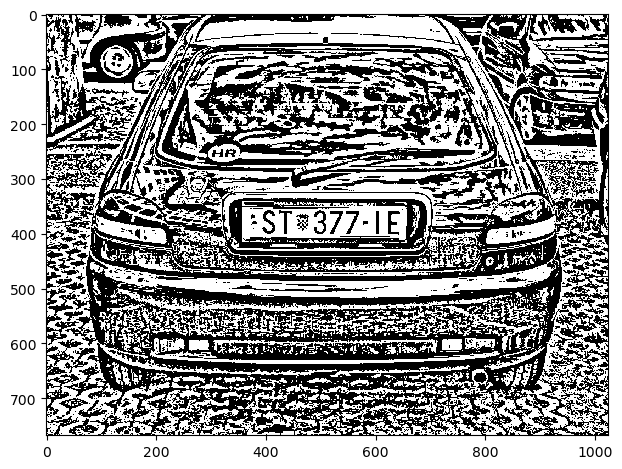

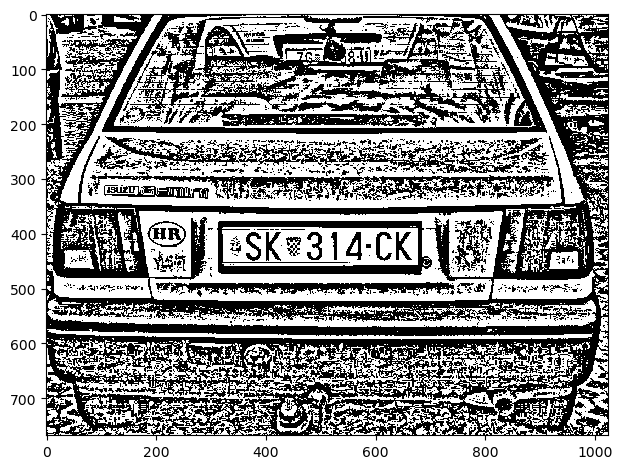

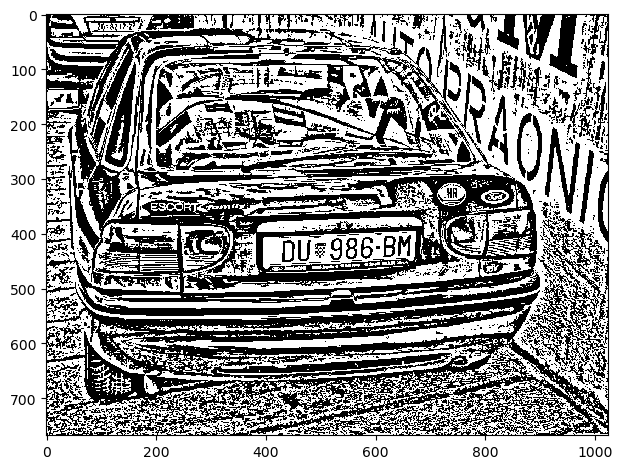

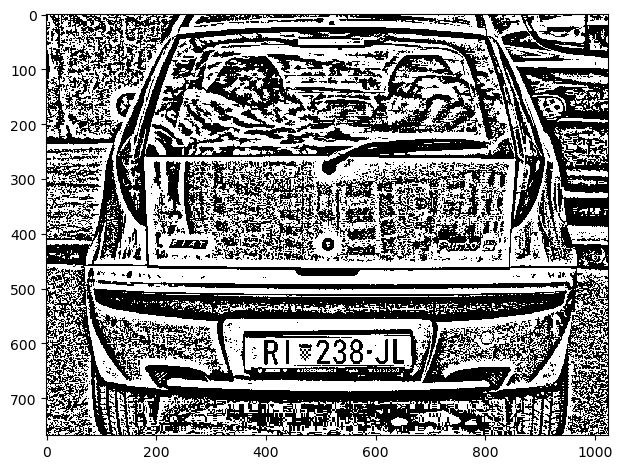

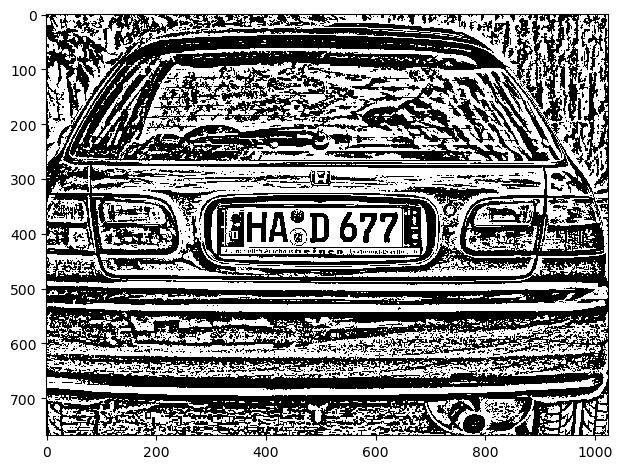

In [8]:
dataset_mono = binariza_frames(dataset_gris)
mostrar_frames(dataset_mono)

### Segmentación

Una vez binarizadas estamos en condiciones de realizar la segmentación (identificación de caracteres):



In [9]:
def extraccion_de_rois(imgs, debug=False):
    out = []
    
    for img in imgs:
        # Invertir la imagen binaria para que los caracteres sean blancos sobre fondo negro
        img_inv = invert(img)
        
        # Etiquetar las regiones conectadas
        label_image = label(img_inv)
        
        # Obtener las propiedades de las regiones
        regions = regionprops(label_image)
        
        # Si debug es True, mostrar los ROIs
        if debug:
            mostrar_rois(img, regions)
            
        out.append(regions)
        
    return out

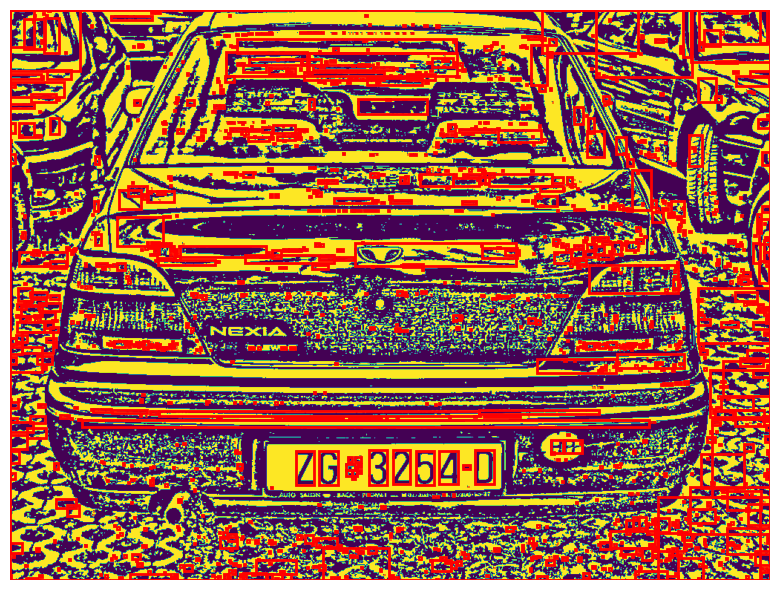

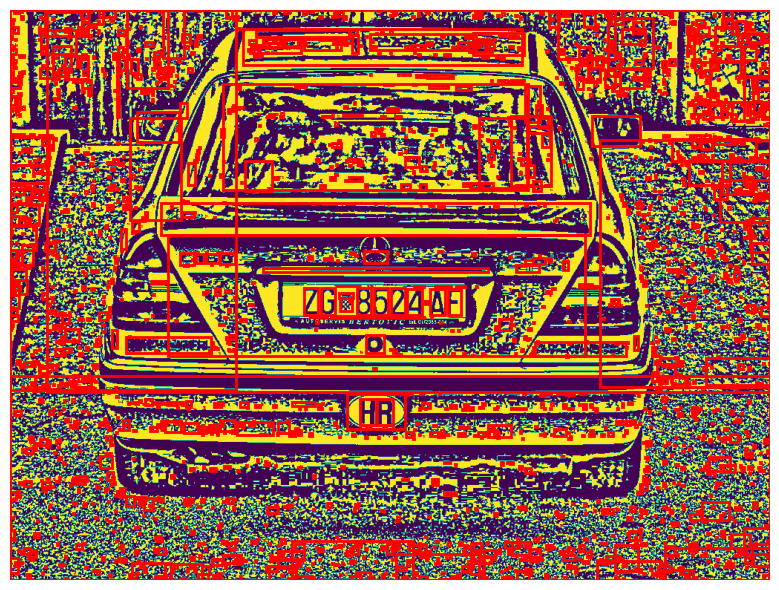

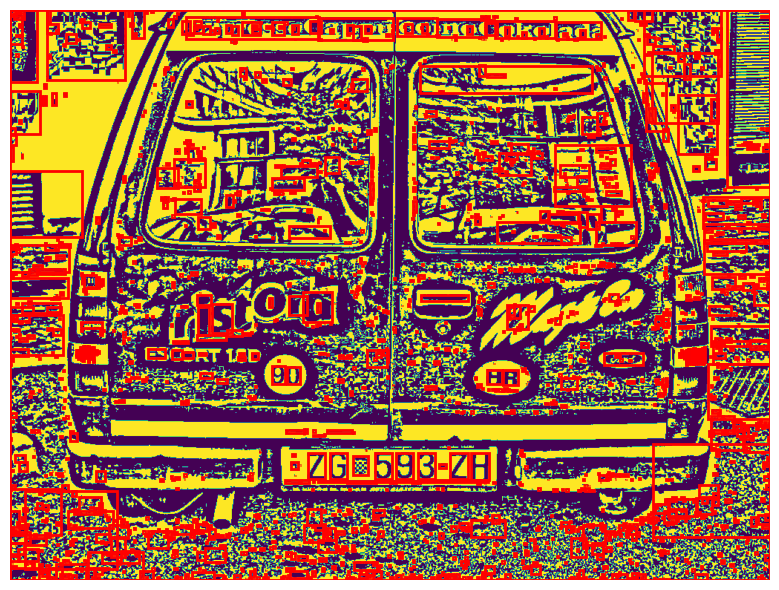

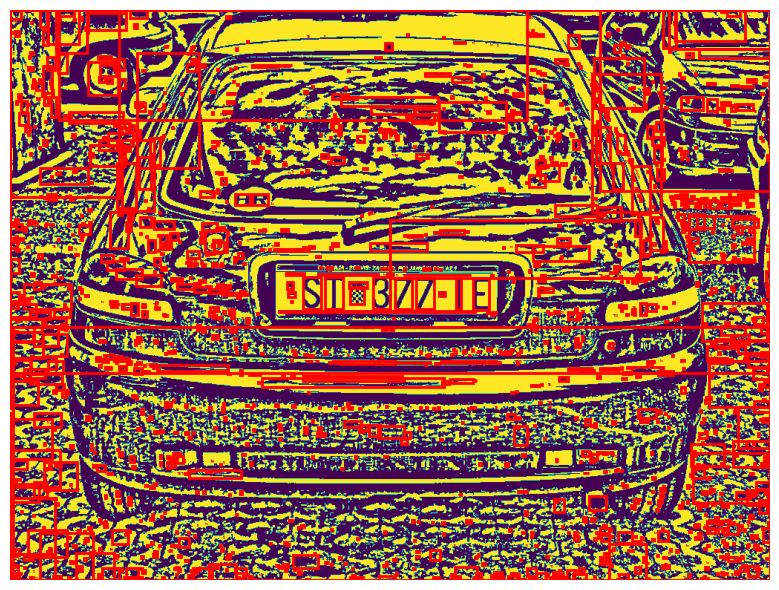

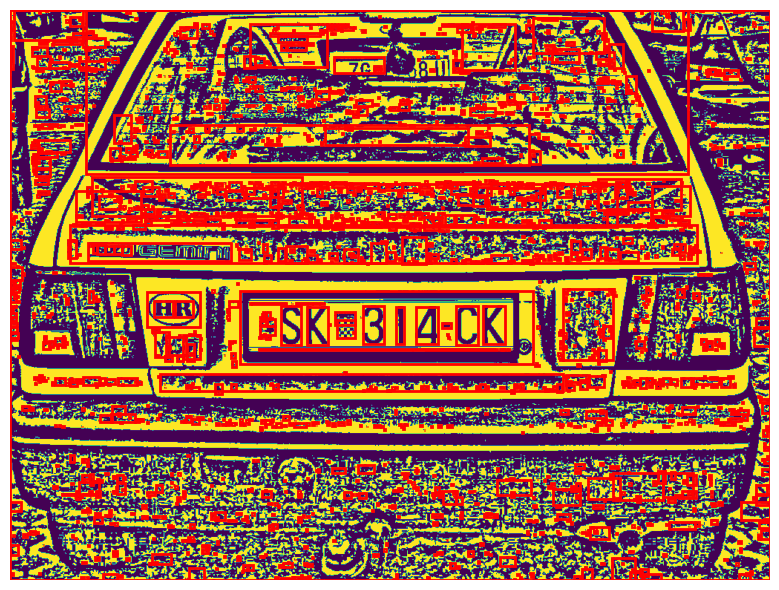

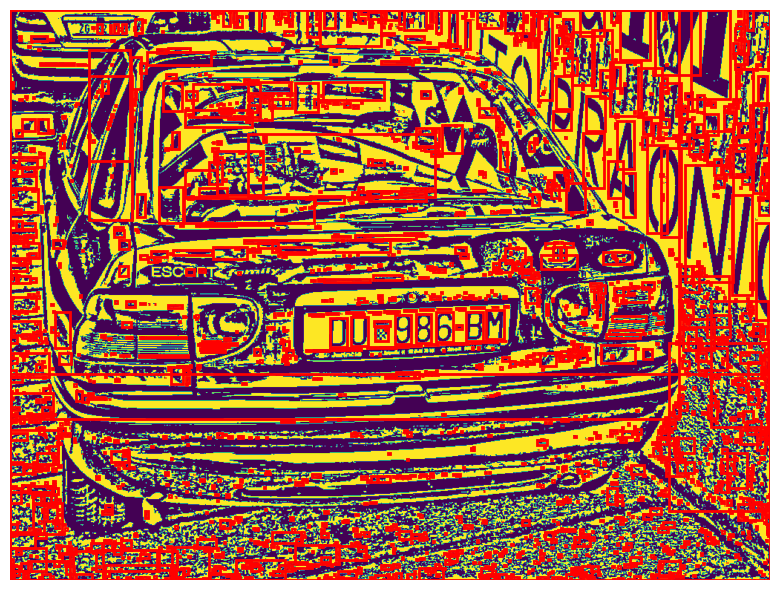

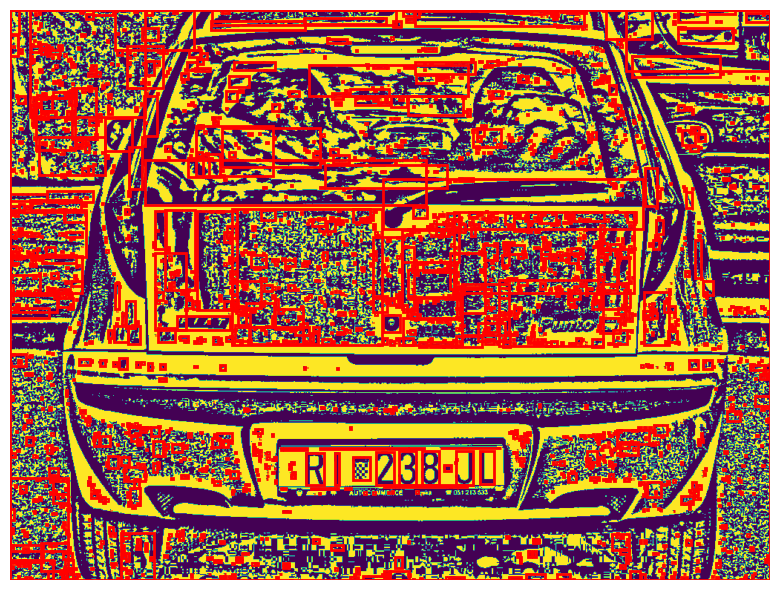

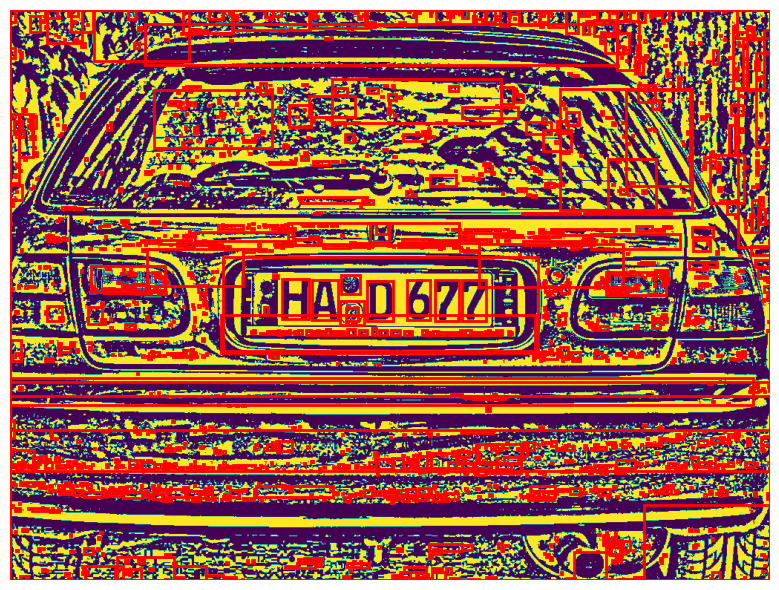

In [10]:
dataset_rois = extraccion_de_rois(dataset_mono, debug=True)

### Filtrado de rois 

En los resultados de los rois hay muchos falsos positivos. 


In [11]:

def filtrar_rois(rois, area_min=200, area_max=400):
    rois_filtered = []
    for roi in rois:
        if roi.area >= area_min and roi.area <= area_max:
            rois_filtered.append(roi)
                 
    return rois_filtered

In [12]:
def limpiar_rois(dataset_rois, imgs, debug=True):
    out = []
    
    for i, rois_in_image in enumerate(dataset_rois):
        # 1. Filtrado inicial por área.
        candidate_rois = filtrar_rois(rois_in_image, area_min=150, area_max=4000)

        # 2. Búsqueda de la matrícula como un cluster de ROIs.
        clusters = []
        candidate_rois.sort(key=lambda r: r.bbox[1]) 

        for roi in candidate_rois:
            y1, x1, y2, x2 = roi.bbox
            roi_height = y2 - y1
            
            found_cluster = False
            for cluster in clusters:
                last_roi_in_cluster = cluster[-1]
                ly1, lx1, ly2, lx2 = last_roi_in_cluster.bbox
                last_roi_height = ly2 - last_roi_in_cluster.bbox[0]

                y_center_roi = y1 + roi_height / 2
                y_center_last_roi = ly1 + last_roi_height / 2
                vertical_distance = abs(y_center_roi - y_center_last_roi)
                horizontal_distance = x1 - lx2
                height_ratio = roi_height / last_roi_height if last_roi_height > 0 else 0

                if (vertical_distance < roi_height * 0.5 and
                    horizontal_distance < roi_height * 2 and
                    0.5 < height_ratio < 1.7):
                    cluster.append(roi)
                    found_cluster = True
                    break
            
            if not found_cluster:
                clusters.append([roi])

        # 3. Selección del mejor cluster (el que más probablemente sea una matrícula)
        best_cluster = []
        if clusters:
            valid_clusters = [c for c in clusters if 4 <= len(c) <= 9]
            if valid_clusters:
                best_cluster = max(valid_clusters, key=len)
 
        final_rois = []
        if best_cluster:
            for roi in best_cluster:
                y1, x1, y2, x2 = roi.bbox
                height = y2 - y1
                width = x2 - x1
                
                # Evitar división por cero si la altura es 0
                if height == 0:
                    continue
                
                aspect_ratio = width / height
                
                if aspect_ratio < 1.5:
                    final_rois.append(roi)
            
        if debug and i < len(imgs):
            mostrar_rois(imgs[i], final_rois)
            
        out.append(final_rois)
        
    return out

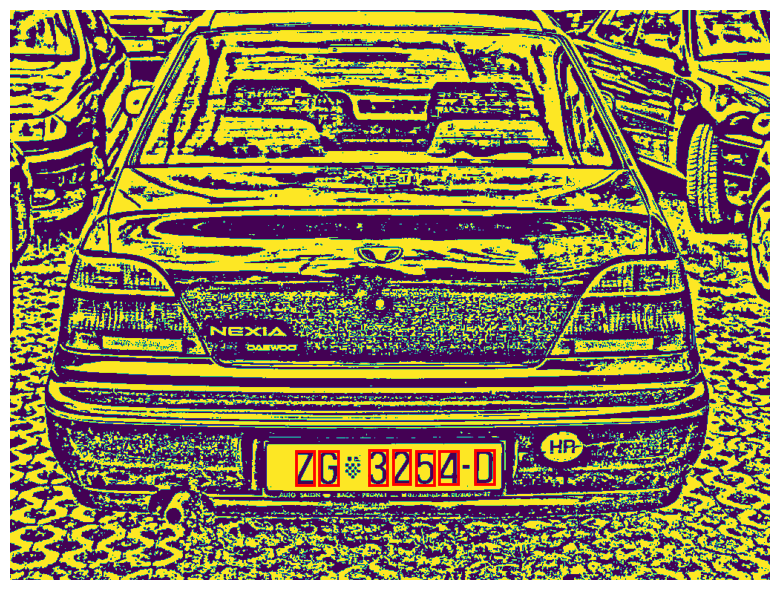

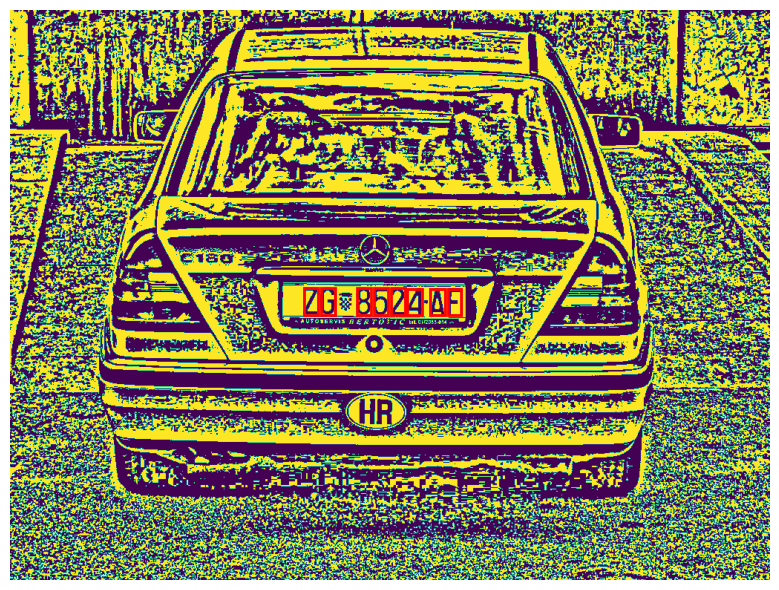

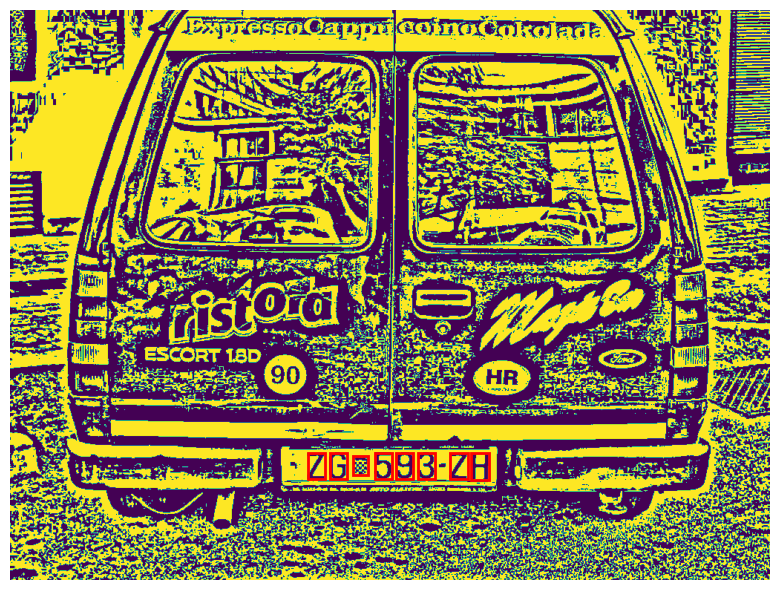

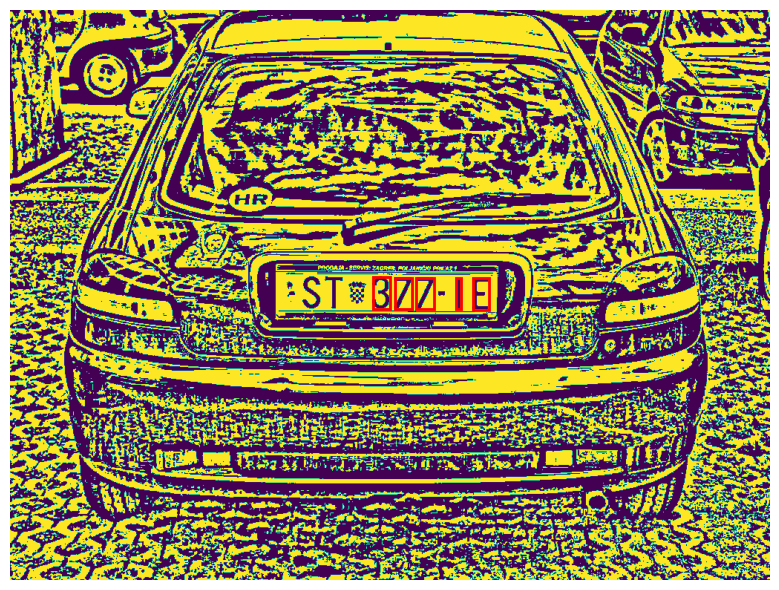

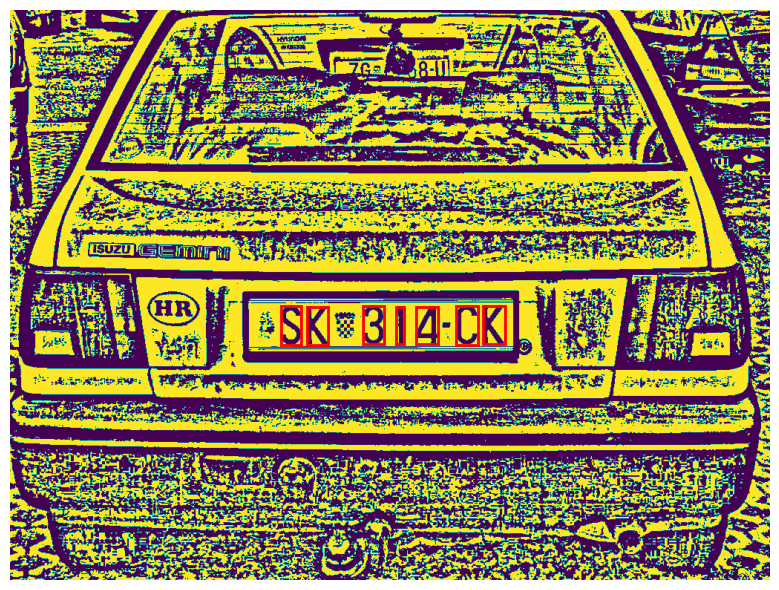

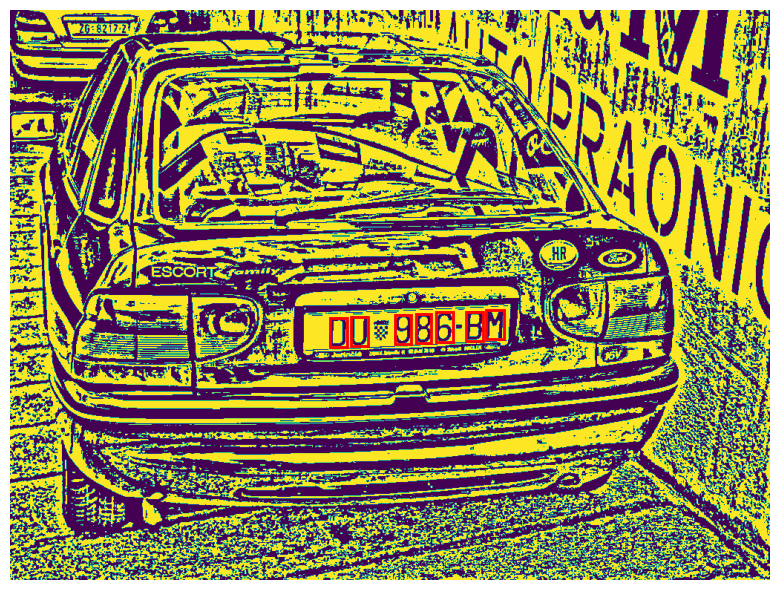

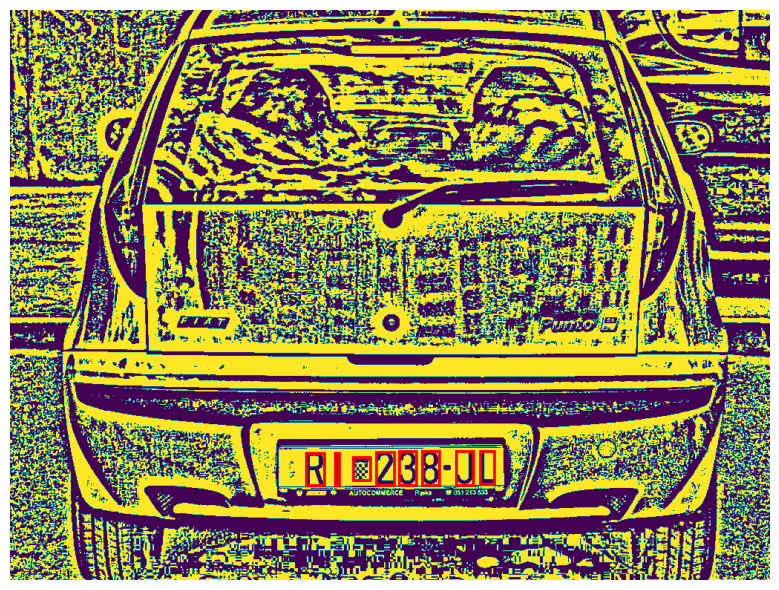

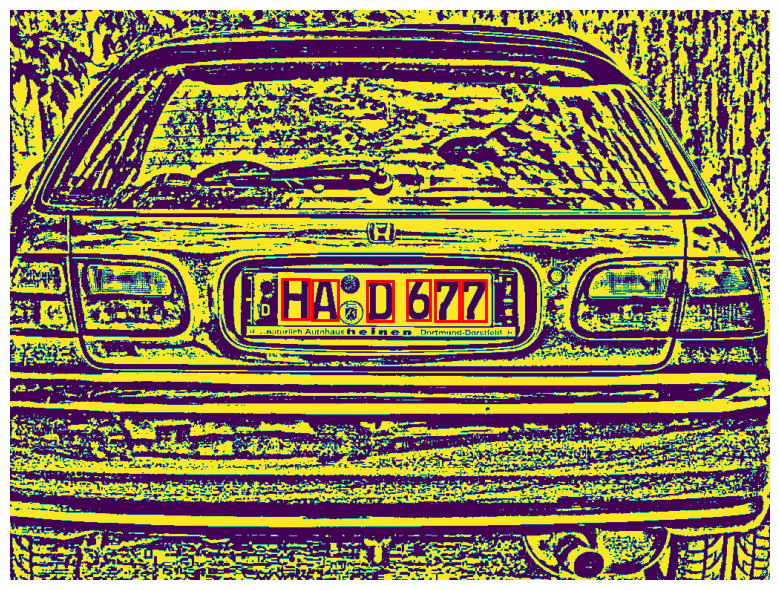

In [13]:
dataset_rois_filtered = limpiar_rois(dataset_rois, dataset_mono, debug=True)

### Entrenamiento del modelo Una vez segmentada la imagen vamos a clasificar los rois obtenidos para ello vamos a generar un dataset y cargarlo:



In [14]:
genera_dataset("corpus", fonts_folder="fonts") # Puedes ver el código de esta función en ocr.py

In [15]:
X, y, clases = carga_dataset("corpus") # Puedes ver el código de esta función en ocr.py

{54: '0', 55: '1', 56: '2', 57: '3', 58: '4', 59: '5', 60: '6', 61: '7', 62: '8', 63: '9', 27: 'A', 28: 'B', 29: 'C', 30: 'D', 31: 'E', 32: 'F', 33: 'G', 34: 'H', 35: 'I', 36: 'J', 37: 'K', 38: 'L', 39: 'M', 40: 'N', 42: 'O', 43: 'P', 44: 'Q', 45: 'R', 46: 'S', 47: 'T', 48: 'U', 49: 'V', 50: 'W', 51: 'X', 52: 'Y', 53: 'Z', 0: 'a', 1: 'b', 2: 'c', 3: 'd', 4: 'e', 5: 'f', 6: 'g', 7: 'h', 8: 'i', 9: 'j', 10: 'k', 11: 'l', 12: 'm', 13: 'n', 15: 'o', 16: 'p', 17: 'q', 18: 'r', 19: 's', 20: 't', 21: 'u', 22: 'v', 23: 'w', 24: 'x', 25: 'y', 26: 'z', 41: 'Ñ', 14: 'ñ'}
Cargadas 4800 instancias con 64 atributos. Clases 64.


Entrena el modelo con el dataset proporcionado y evalúa su score.



In [24]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Redimensionar las imágenes a vectores de características
n_samples = len(X)
X_reshaped = X.reshape((n_samples, -1))

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(
    X_reshaped, y, test_size=0.2, random_state=42
)

# Crear y entrenar el modelo
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Evaluar el modelo
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.2f}")

Precisión del modelo: 1.00


### Evaluación

Por último evalúa los rois obtenidos con el modelo entrenado, apoyate en la función `reconoce_roi` que reconoce un roi concreto:



In [38]:
def reconoce_roi(img, roi, model, clases, debug=False):
    top, left, bottom, right = roi.bbox

    # Extraer la ventana original del caracter
    ventana = extraer_ventana(img, left, top, right - left, bottom - top)
    
    h, w = ventana.shape
    
    # Crear un lienzo cuadrado. El tamaño será el del lado más largo del ROI + un pequeño padding.
    lado_cuadrado = max(h, w) + 4
    lienzo = np.zeros((lado_cuadrado, lado_cuadrado), dtype=ventana.dtype)
    
    # Calcular la posición para centrar la ventana en el lienzo
    paste_x = (lado_cuadrado - w) // 2
    paste_y = (lado_cuadrado - h) // 2
    
    # Pegar la ventana en el lienzo
    lienzo[paste_y:paste_y+h, paste_x:paste_x+w] = ventana
    
    #ventana_scaled = transform.resize(lienzo, (8, 8), anti_aliasing=True)
    ventana_scaled = transform.resize(lienzo.astype(float), (8, 8), anti_aliasing=True)

    # --- FIN DE LA MEJORA ---
    
    if debug:
        print("Original:")
        io.imshow(ventana)
        io.show()
        print("Preprocesada (normalizada y escalada):")
        io.imshow(ventana_scaled)
        io.show()
    
    y_predicted_filtered = int(model.predict(ventana_scaled.reshape(1, 64)))
    letra = clases[y_predicted_filtered]
    
    if debug:
        print("Clase predicha: {}\n\n".format(letra))
        
    return letra, y_predicted_filtered

In [39]:
def reconoce_imgs(imgs_gris, imgs_rgb, dataset_rois):

    
    for i, (img_gray, img_rgb, rois) in enumerate(zip(imgs_gris, imgs_rgb, dataset_rois)):
        print(f"Procesando imagen {i+1}/{len(imgs_gris)}")
        
        # Lista para almacenar las coincidencias (roi, letra)
        matches = []
        
        # Procesar cada ROI
        for roi in rois:
            # Obtener la letra predicha
            letra, _ = reconoce_roi(img_gray, roi, model, clases, debug=False)
            
            # Guardar la tupla (roi, letra)
            matches.append((roi, letra))
        
        # Ordenar los caracteres de izquierda a derecha
        matches_ordenados = sorted(matches, key=lambda x: x[0].bbox[1])  # Ordenar por coordenada x (columna)
        
        # Extraer caracteres ordenados
        caracteres_ordenados = [letra for _, letra in matches_ordenados]
        print(f"Matrícula reconocida: {''.join(caracteres_ordenados)}")
        
        # Mostrar la imagen con los caracteres reconocidos
        dibujar_matches(img_rgb, matches_ordenados)

Procesando imagen 1/8
Matrícula reconocida: BaRiila


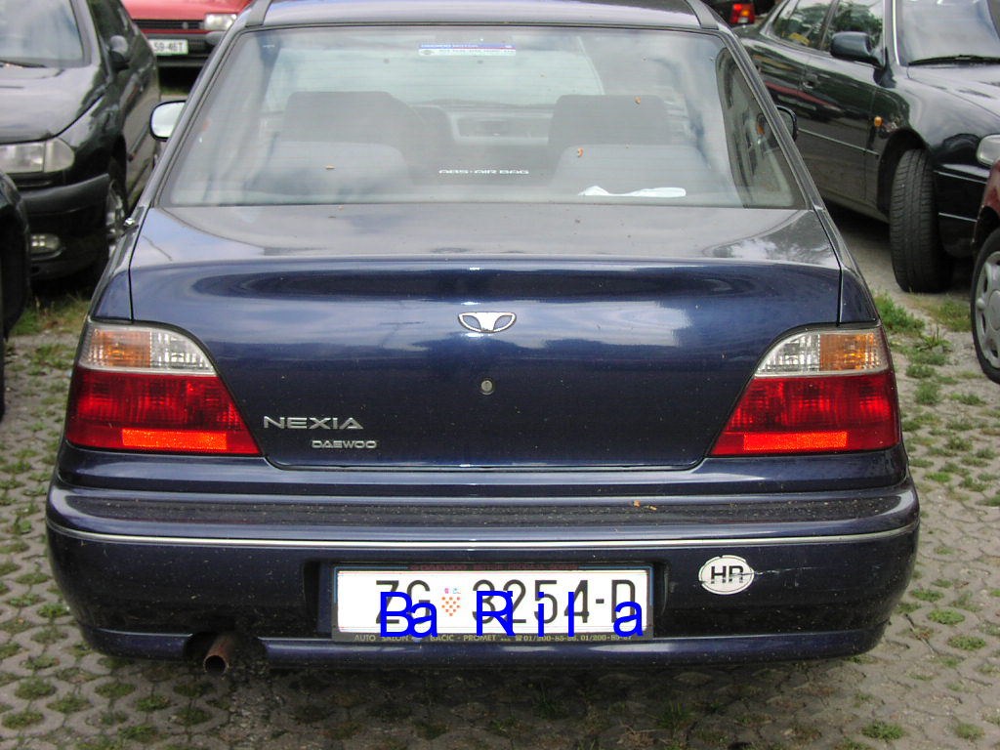

Procesando imagen 2/8
Matrícula reconocida: iiaiiIiB


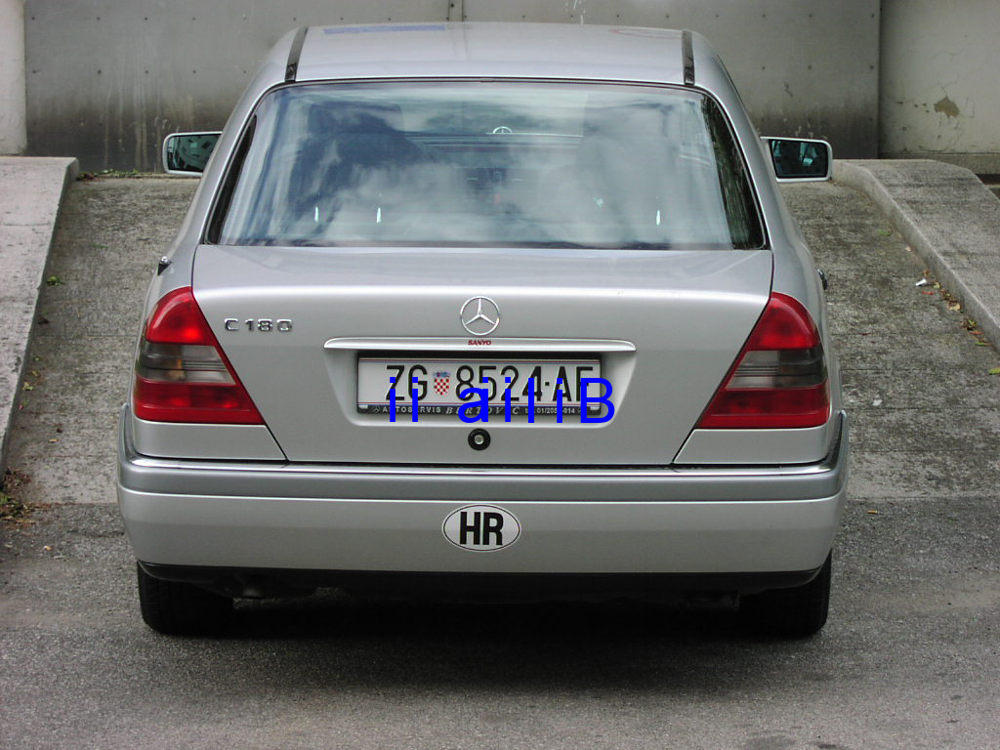

Procesando imagen 3/8
Matrícula reconocida: BaliiiBB


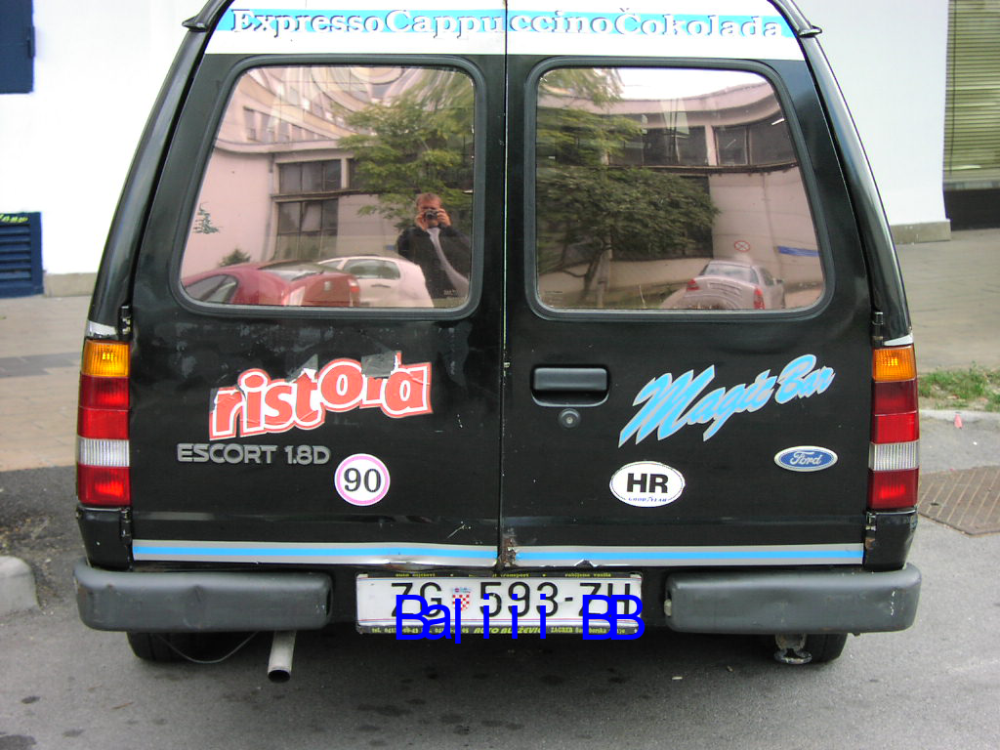

Procesando imagen 4/8
Matrícula reconocida: RimIB


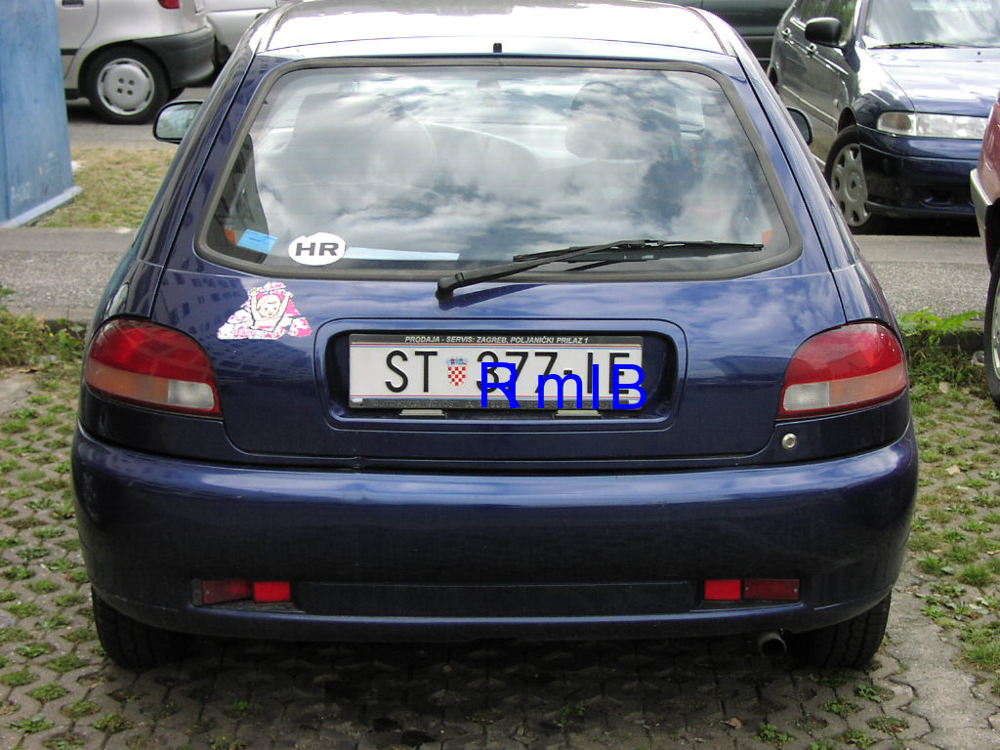

Procesando imagen 5/8
Matrícula reconocida: iiaIlai


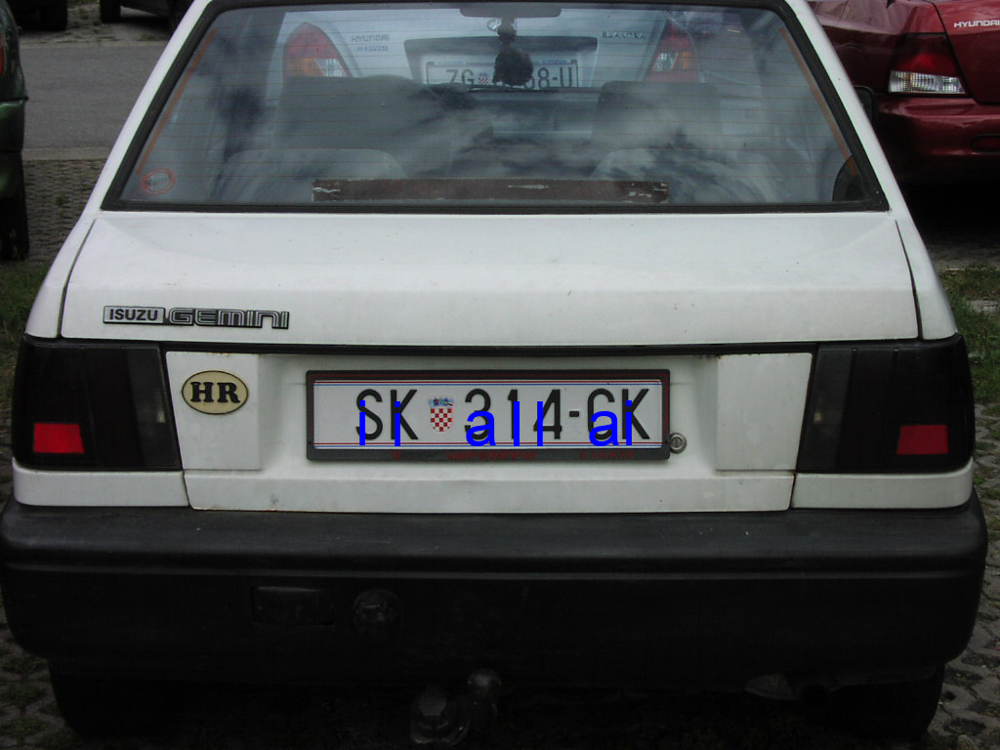

Procesando imagen 6/8
Matrícula reconocida: aaaaial


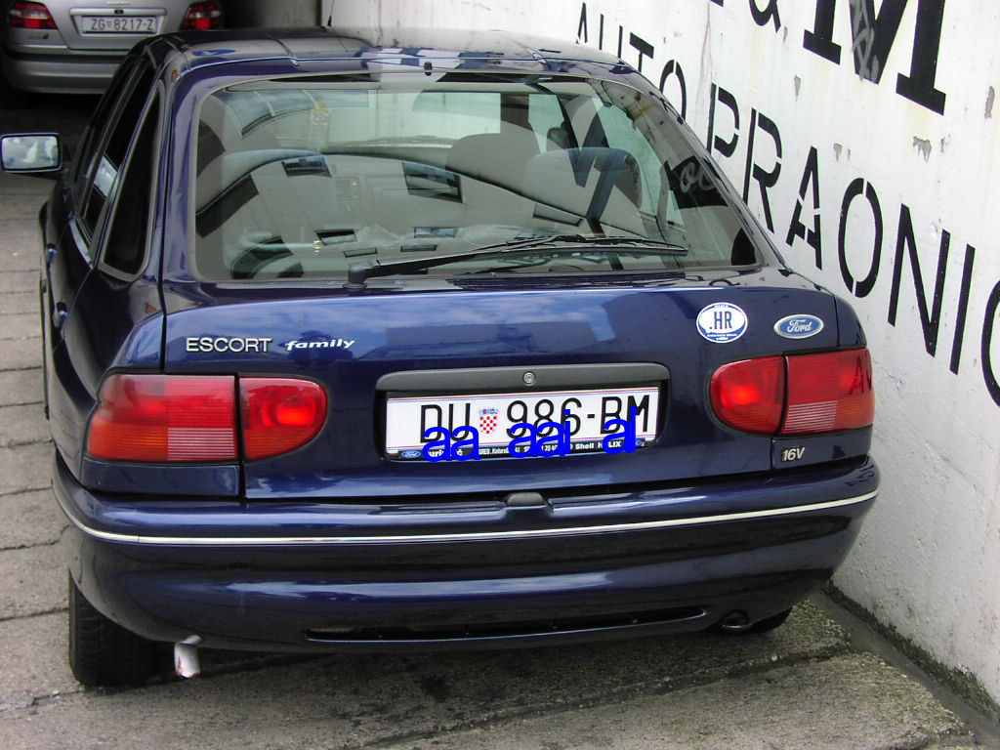

Procesando imagen 7/8
Matrícula reconocida: lIliRliB


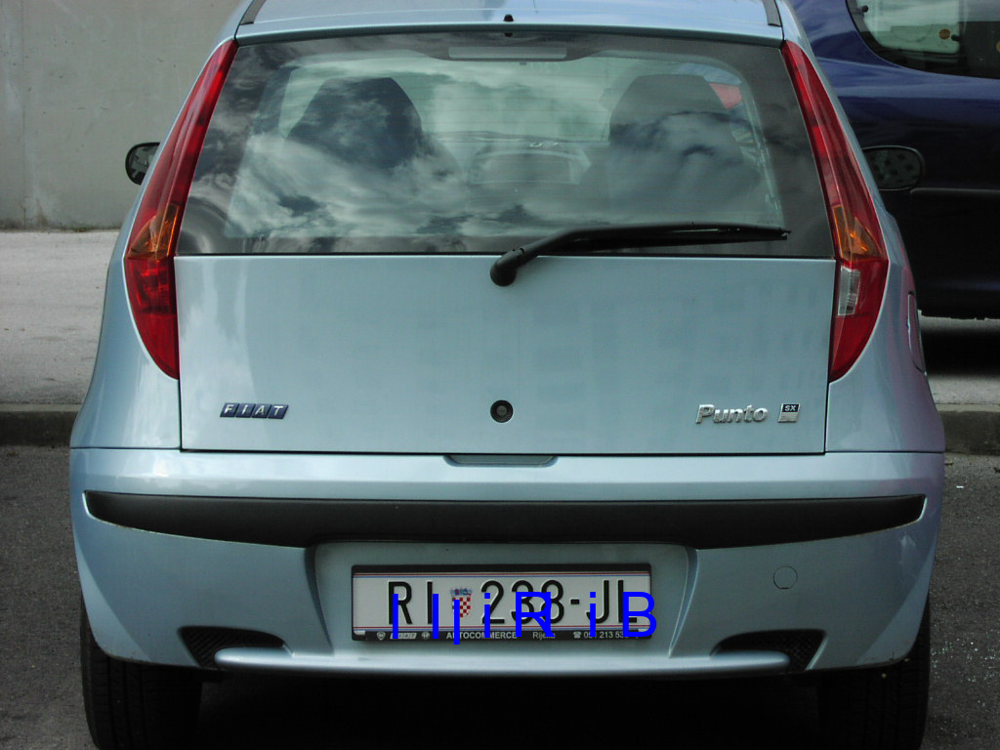

Procesando imagen 8/8
Matrícula reconocida: Rliimm


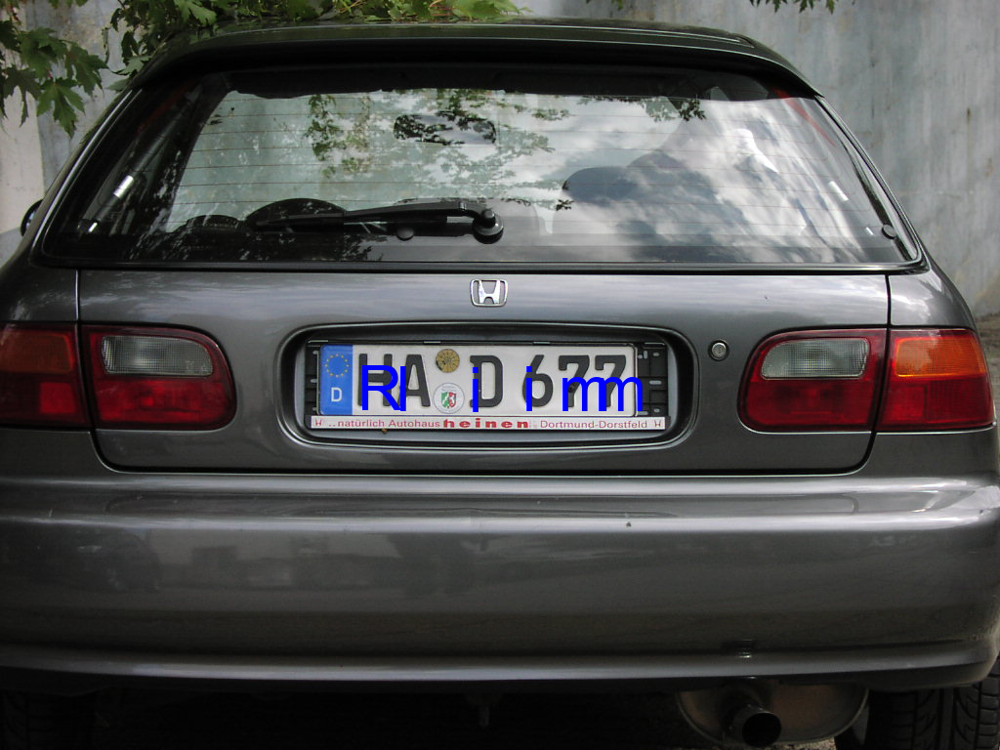

In [40]:
#reconoce_imgs(dataset_gris, dataset_rgb, dataset_rois_filtered)
reconoce_imgs(dataset_mono, dataset_rgb, dataset_rois_filtered)



### Conclusiones* Se analiza  Cómo mejorarías el algoritmo.



In [20]:
"""
Segmentar solo el área de los caracteres sin perder información relevante 
resultó complicado; tras muchas pruebas, logré una solución medianamente funcional.

El modelo de reconocimiento tampoco predice bien, probablemente por falta de 
preprocesamiento, cuando mejoré el área de la metricula también volví mas erratica la predicción, 
creo que esta relacionado con el cómo lo estoy tratando o enviando al modelo.

Para mejorarlo, probaría 

Primero, validar y refinar el pre-procesamiento. A pesar de las iteraciones, es fundamental 
explorar técnicas adicionales de tratamiento de imagen para asegurar la máxima calidad y consistencia 
de los caracteres antes de ser clasificados. 

Segundo, y de forma crítica, re-estructurar el sistema de reconocimiento. 

"""




'\nSegmentar solo el área de los caracteres sin perder información relevante \nresultó complicado; tras muchas pruebas, logré una solución medianamente funcional.\n\nEl modelo de reconocimiento tampoco predice bien, probablemente por falta de \npreprocesamiento o entrenamiento adecuado.\nPara mejorarlo, probaría \n\nPrimero, validar y refinar el pre-procesamiento. A pesar de las iteraciones, es fundamental \nexplorar técnicas adicionales de tratamiento de imagen para asegurar la máxima calidad y consistencia \nde los caracteres antes de ser clasificados. \n\nSegundo, y de forma crítica, re-estructurar el sistema de reconocimiento. Dado el bajo rendimiento \ndel modelo actual, el enfoque sería aumentar y diversificar los datos de entrenamiento para que \naprenda más ejemplos, y evaluar algoritmos de clasificación alternativos que puedan \nofrecer mayor robustez. Este proceso requiere un ciclo de experimentación para ajustar y validar \nlos resultados.\n\n'